<h1 align="center">Hacettepe University <br> Department of Computer Science </h1> 

<h2 align="center">BBM 415 - Fundamentals of Image Processing Laboratory<br>2022 Fall</h2>

<h3 align="center">Assignment 2</h3>
<h3 align="left">Name    :    Murat Çelik</h3>
<h3 align="left">ID      :    21827263</h3>
<h4 align="right">Due on November 14, 2022</h4>

# Problem Definition

* Color manipulation on photographs has become a rapidly increasing problem with the use of social media. There are different solutions to this problem. As one of these solutions, the RGB-edited picture has a difficult solution for this problem, "lab color space" was developed as an alternative. This color space makes it easy to change the color effect in images.

* In this assignment, we will apply color effects change on our source image depending on our target image.

In [1]:
import numpy as np
import cv2
from matplotlib import pyplot as plt 

## Part 1

In [82]:
def base_color_transfer(source_img,target_img):
    
    
    # 1. Convert the source and target images to lαβ color space representation from RGB color space
    source = cv2.cvtColor(source_img, cv2.COLOR_BGR2LAB).astype("float32")
    target = cv2.cvtColor(target_img, cv2.COLOR_BGR2LAB).astype("float32") 
    
    # 2. For each channel of source and target images, compute means (μl, μα, μβ ) and standard deviations (σl, σα, σβ ).
    def compute_mean_std(image):
        # compute the mean and standard deviation of each channel
        (l, alpha, beta) = cv2.split(image)
        (lMean, lStd) = (l.mean(), l.std())
        (alphaMean, alphaStd) = (alpha.mean(), alpha.std())
        (betaMean, betaStd) = (beta.mean(), beta.std())
        # return the color statistics
        return (lMean, lStd, alphaMean, alphaStd, betaMean, betaStd)

    (lMeanSrc, lStdSrc, alphaMeanSrc, alphaStdSrc, betaMeanSrc, betaStdSrc) = compute_mean_std(source)
    (lMeanTar, lStdTar, alphaMeanTar, alphaStdTar, betaMeanTar, betaStdTar) = compute_mean_std(target)
    
    # 3. Subtract means from the data points for source image:
    (l, a, b) = cv2.split(source)
    l -= lMeanSrc
    a -= alphaMeanSrc
    b -= betaMeanSrc
    
    # 4. Scale new data points according to the relative standard deviations of target and source images:
    l = (lStdTar / (lStdSrc + 0.000001) ) * l
    a = (alphaStdTar / (alphaStdSrc + 0.000001)) * a
    b = (betaStdTar/ (betaStdSrc + 0.000001)) * b
    
    # 5. Add the averages computed for the target to scaled data points.
    l += lMeanTar
    a += alphaMeanTar
    b += betaMeanTar
    
    l = np.clip(l, 0, 255)
    a = np.clip(a, 0, 255)
    b = np.clip(b, 0, 255)
    
    result = cv2.merge([l, a, b])
    result = cv2.cvtColor(result.astype("uint8"), cv2.COLOR_LAB2BGR)
    
    return source_img, target_img, result


def visual_img(source, target, result, img_num):
    f, axarr = plt.subplots(1,3, figsize=(15,3.5))
    axarr[0].imshow(cv2.cvtColor(source, cv2.COLOR_BGR2RGB))
    axarr[1].imshow(cv2.cvtColor(target, cv2.COLOR_BGR2RGB))
    axarr[2].imshow(cv2.cvtColor(result, cv2.COLOR_BGR2RGB))

    axarr[0].title.set_text(f"Source Image")
    axarr[1].title.set_text(f"Target Image")
    axarr[2].title.set_text(f"Result Image")
    f.suptitle(f'Image Number is {img_num}')
    
    

    
def plot_histogram(source,target,result, title, mask=None):
    
    sources = cv2.split(source)
    targets = cv2.split(target)
    results = cv2.split(result)
    images = [sources, targets, results]
    f, axarr = plt.subplots(1,3, figsize=(15,4))
    colors = ("b", "g", "r")
    f.suptitle(title)

    for i in range(len(images)):
        chans = images[i]
        for (chan, color) in zip(chans, colors):
            # create a histogram for the current channel and plot it
            hist = cv2.calcHist([chan], [0], mask, [256], [0, 256])
            axarr[i].plot(hist, color=color)
            axarr[i].set_xlabel("Bins")
            axarr[i].set_ylabel("# of Pixels")
            plt.xlim([-5, 256])

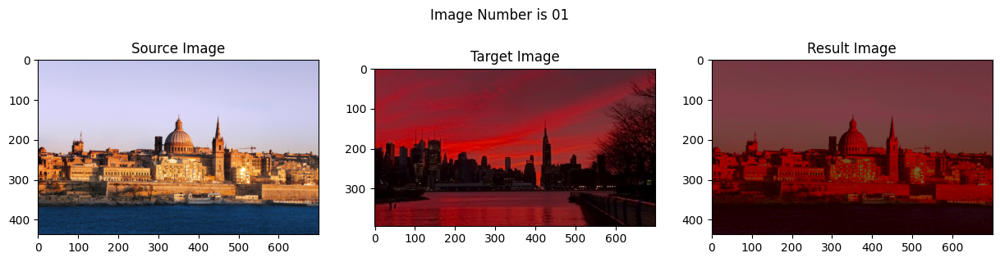

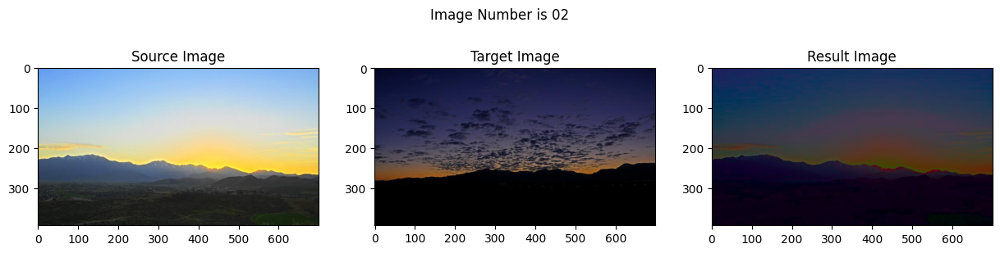

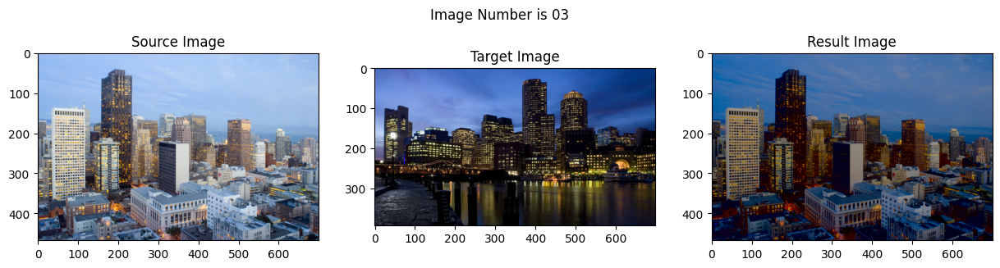

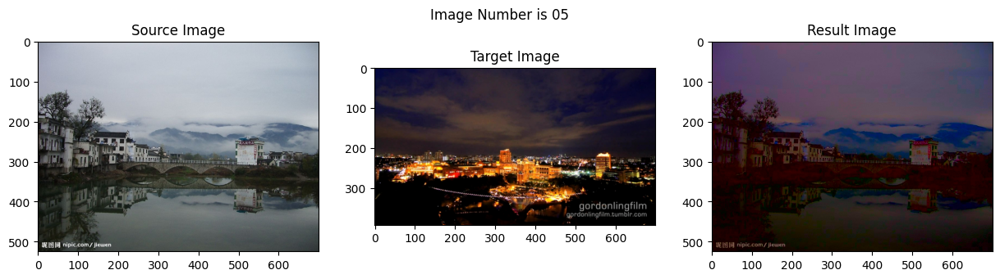

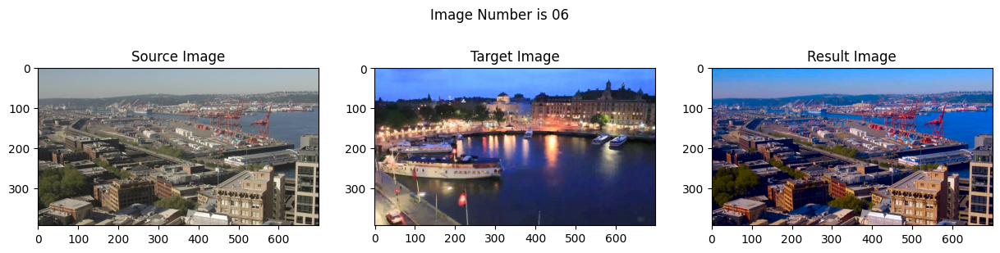

...

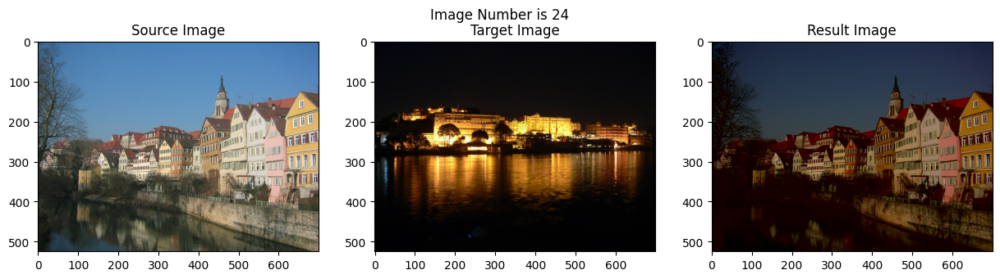

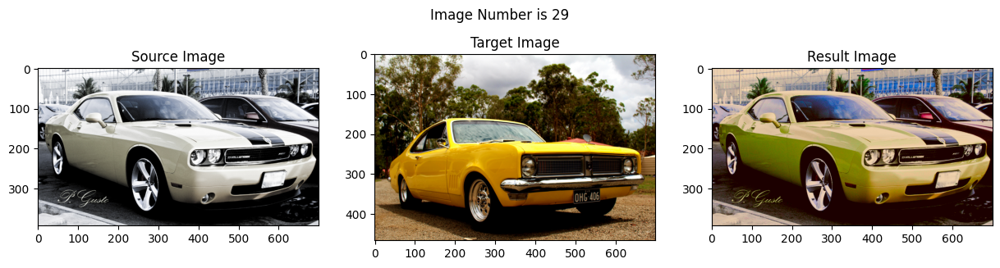

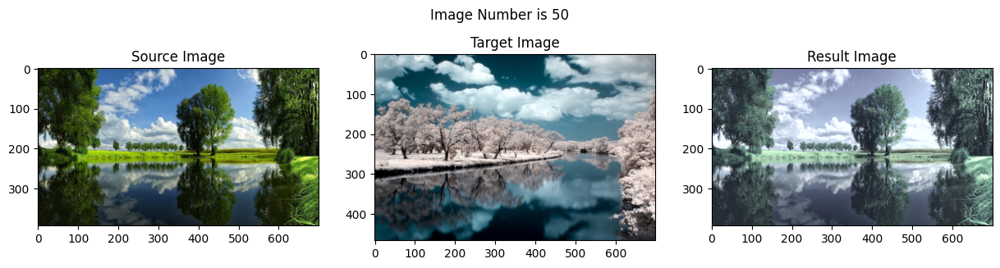

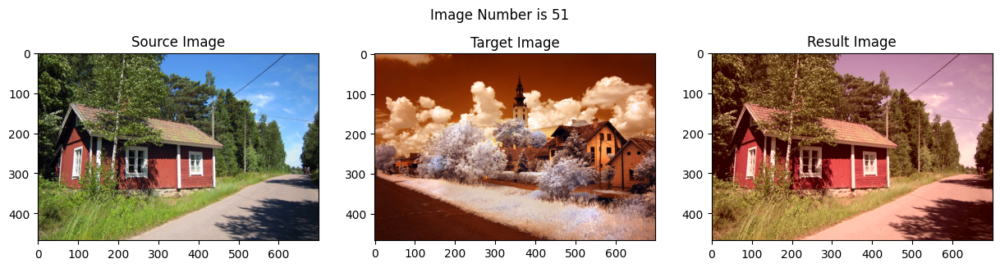

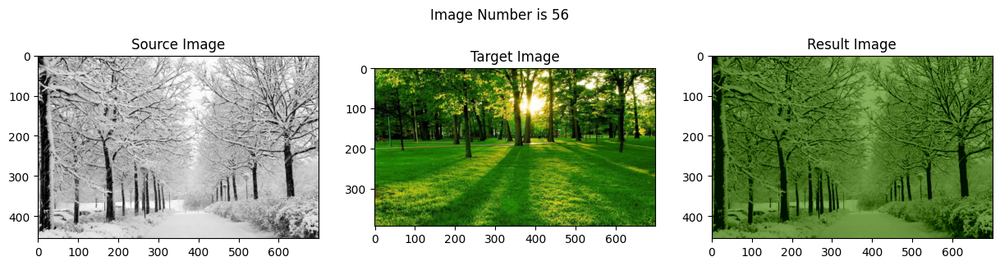

In [83]:
for img_number in ["01","02","03","05","06","08","09","11","15","20","24","29","50","51","56"]:
    
    source_img = "data/in_"  + str(img_number) + ".png"
    target_img = "data/tar_" + str(img_number) + ".png"
    source_img = cv2.imread(source_img)
    target_img = cv2.imread(target_img)
    
    source, target, result = base_color_transfer(source_img, target_img)
    visual_img(source, target, result, img_number)

### Image Number 1

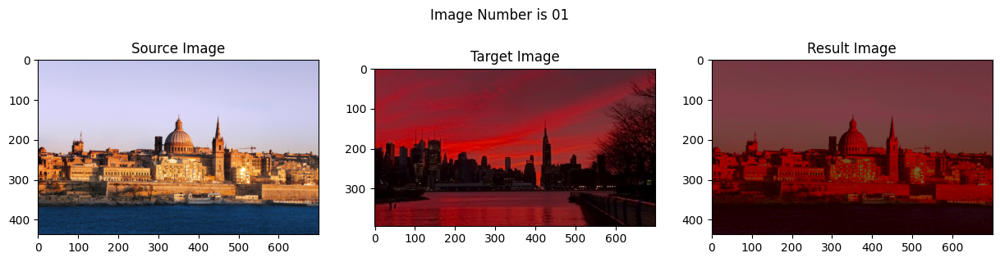

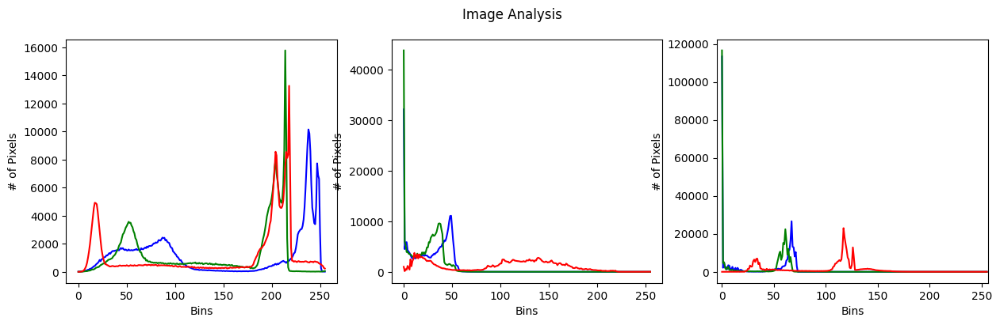

In [86]:
img_number = "01"
source_img = "data/in_"  + str(img_number) + ".png"
target_img = "data/tar_" + str(img_number) + ".png"
source_img = cv2.imread(source_img)
target_img = cv2.imread(target_img)

source, target, result = base_color_transfer(source_img, target_img)
visual_img(source, target, result, img_number)
plot_histogram(source,target,result, "Image Analysis", mask=None)

### Image Number 56

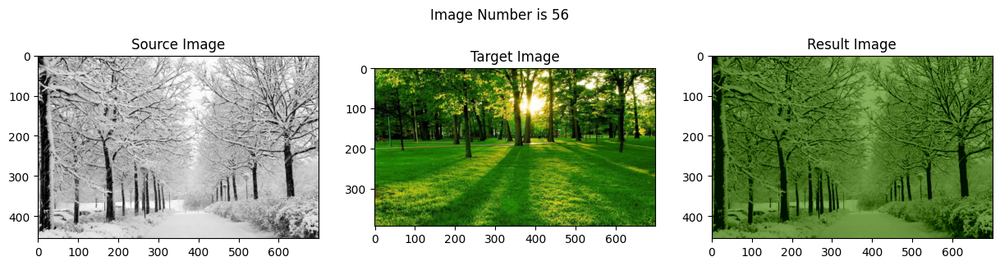

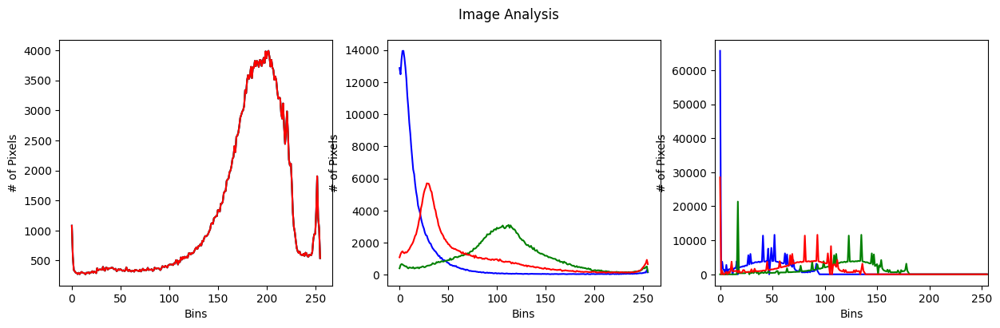

In [88]:
img_number = "56"
source_img = "data/in_"  + str(img_number) + ".png"
target_img = "data/tar_" + str(img_number) + ".png"
source_img = cv2.imread(source_img)
target_img = cv2.imread(target_img)

source, target, result = base_color_transfer(source_img, target_img)
visual_img(source, target, result, img_number)
plot_histogram(source,target,result, "Image Analysis", mask=None)

### Image Number 09

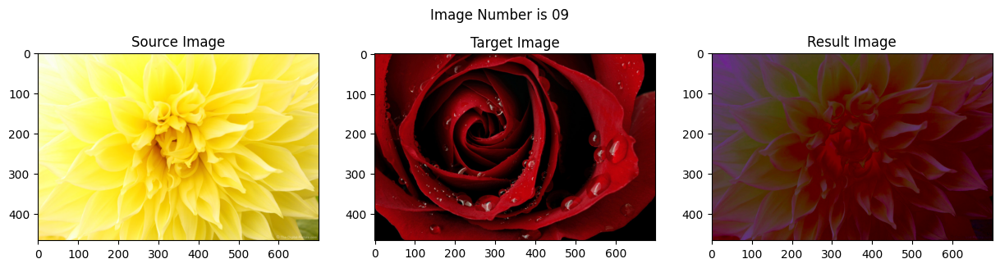

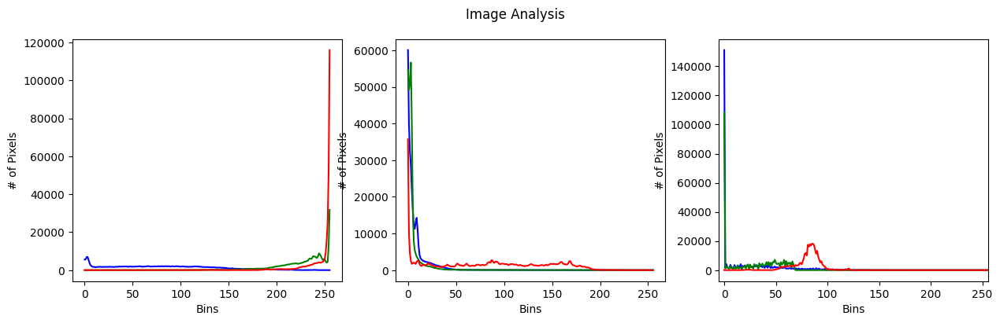

In [89]:
img_number = "09"
source_img = "data/in_"  + str(img_number) + ".png"
target_img = "data/tar_" + str(img_number) + ".png"
source_img = cv2.imread(source_img)
target_img = cv2.imread(target_img)

source, target, result = base_color_transfer(source_img, target_img)
visual_img(source, target, result, img_number)
plot_histogram(source,target,result, "Image Analysis", mask=None)

# PART 2

In [4]:
def rect_process(img_number, rect_len):
    
    def SSD(A, B):
        return np.sum(np.sum((A-B)**2))
    
    source_img = "data/in_"  + str(img_number) + ".png"
    result_img = "data/in_"  + str(img_number) + ".png"
    target_img = "data/tar_" + str(img_number) + ".png"

    source_img = cv2.imread(source_img)
    result_img = cv2.imread(result_img)
    target_img = cv2.imread(target_img)

    img_shape_x, img_shape_y, _ = source_img.shape 
    
    
    shape_x,shape_y = 0,0
    diff_x, diff_y = np.Inf, np.Inf
    for num in [512, 768,  1024, 1280]:
        if diff_x > abs(img_shape_x - num):
            diff_x = abs(img_shape_x - num)
            shape_x = num
        if diff_y > abs(img_shape_y - num):
            diff_y = abs(img_shape_y - num)
            shape_y = num

    source_img = cv2.resize(source_img, (shape_y, shape_x))
    result_img = cv2.resize(result_img, (shape_y, shape_x))
    target_img = cv2.resize(target_img, (shape_y, shape_x))
    
    for x_src in range(0,shape_x,rect_len):
        for y_src in range(0,shape_y,rect_len):
            source_img_tmp = source_img[x_src:x_src+rect_len, y_src:y_src+rect_len]
            min_ssd = np.Inf
            best_tar_x, best_tar_y = 0,0
            for x_tar in range(0,shape_x,rect_len):
                for y_tar in range(0,shape_y,rect_len):
                    target_img_tmp = target_img[x_tar:x_tar+rect_len, y_tar:y_tar+rect_len]
                    ssd_score = SSD(source_img_tmp,target_img_tmp)
                    if ssd_score <= min_ssd:
                        best_tar_x, best_tar_y = x_tar,y_tar

            source, target, result = base_color_transfer(source_img_tmp, target_img[best_tar_x:best_tar_x+rect_len, best_tar_y:best_tar_y+rect_len])
            result_img[x_src:x_src+rect_len, y_src:y_src+rect_len] = result
    return source_img, target_img, result_img


def visualize_rect(index_img, first_rect,second_rect, third_rect):
    source_img, target_img, result_img_64 = rect_process(index_img, first_rect)
    source_img, target_img, result_img_128 = rect_process(index_img, second_rect)
    source_img, target_img, result_img_256 = rect_process(index_img, third_rect)


    f, axarr = plt.subplots(1,3, figsize=(15,3.5))
    axarr[0].imshow(cv2.cvtColor(result_img_64, cv2.COLOR_BGR2RGB))
    axarr[1].imshow(cv2.cvtColor(result_img_128, cv2.COLOR_BGR2RGB))
    axarr[2].imshow(cv2.cvtColor(result_img_256, cv2.COLOR_BGR2RGB))

    axarr[0].title.set_text(f"{first_rect}x{first_rect} Image")
    axarr[1].title.set_text(f"{second_rect}x{second_rect} Image")
    axarr[2].title.set_text(f"{third_rect}x{third_rect} Image")
    f.suptitle(f'Image Number is {index_img}')

## Image Num 01

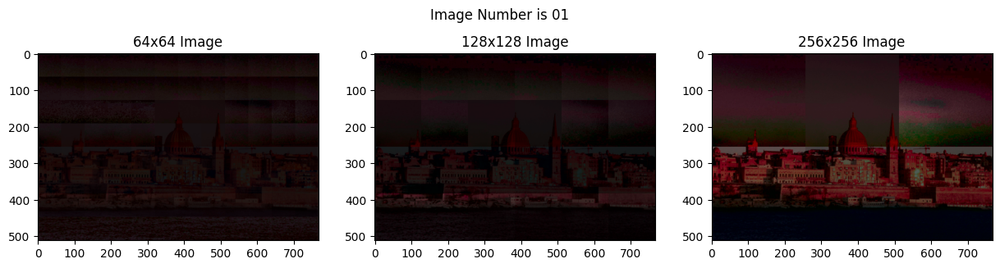

In [5]:
index_img = "01"
visualize_rect(index_img, 64,128, 256)

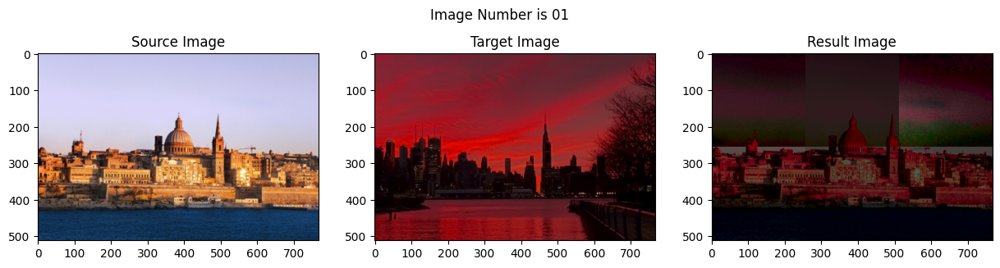

In [6]:
source_img, target_img, result_img = rect_process(index_img, 256)
visual_img(source_img, target_img, result_img,index_img )

## Image Num 02

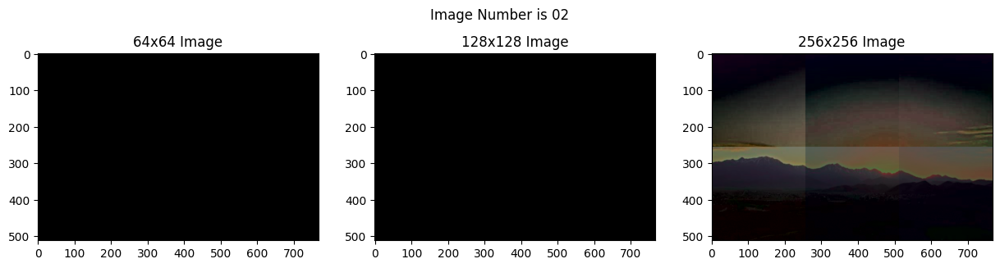

In [7]:
index_img = "02"
visualize_rect(index_img, 64,128, 256)

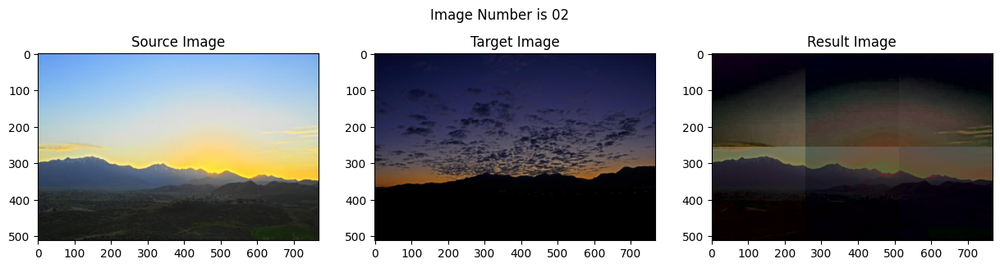

In [8]:
source_img, target_img, result_img = rect_process(index_img, 256)
visual_img(source_img, target_img, result_img,index_img )

## Image Num 03

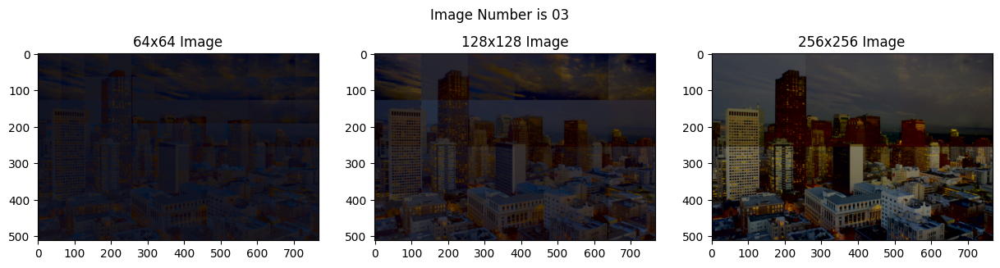

In [9]:
index_img = "03"
visualize_rect(index_img, 64,128, 256)

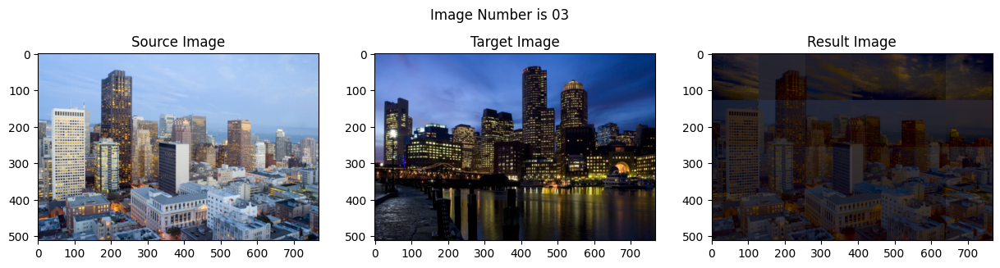

In [10]:
source_img, target_img, result_img = rect_process(index_img, 128)
visual_img(source_img, target_img, result_img,index_img )

## Image Num 05

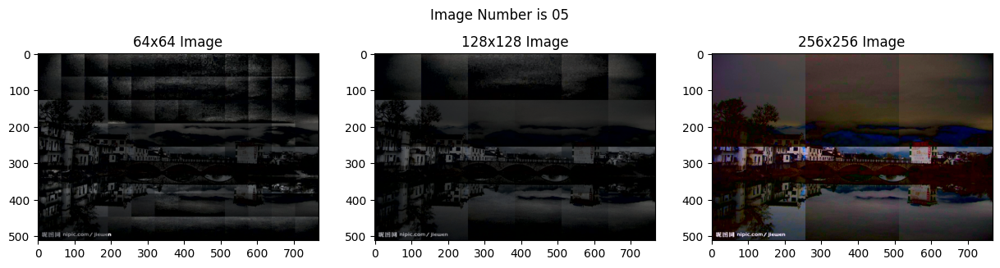

In [11]:
index_img = "05"
visualize_rect(index_img, 64,128, 256)

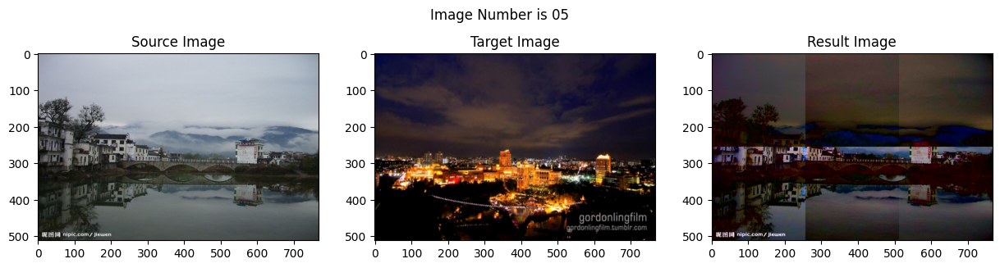

In [12]:
source_img, target_img, result_img = rect_process(index_img, 256)
visual_img(source_img, target_img, result_img,index_img )

## Image Num 06

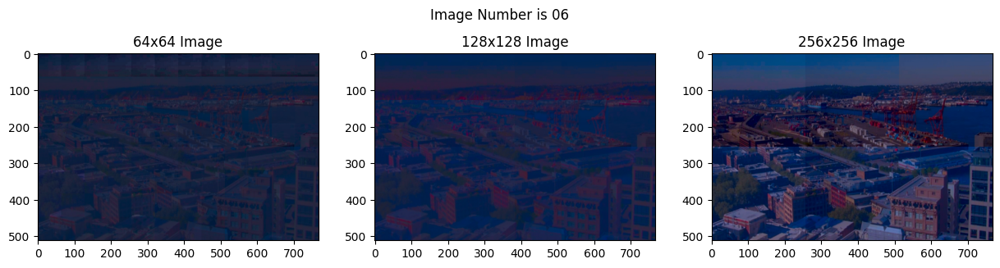

In [13]:
index_img = "06"
visualize_rect(index_img, 64,128, 256)

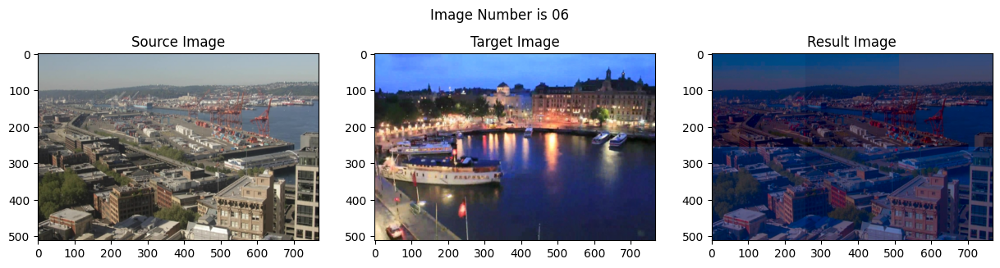

In [14]:
source_img, target_img, result_img = rect_process(index_img, 256)
visual_img(source_img, target_img, result_img,index_img )

## Image Num 08

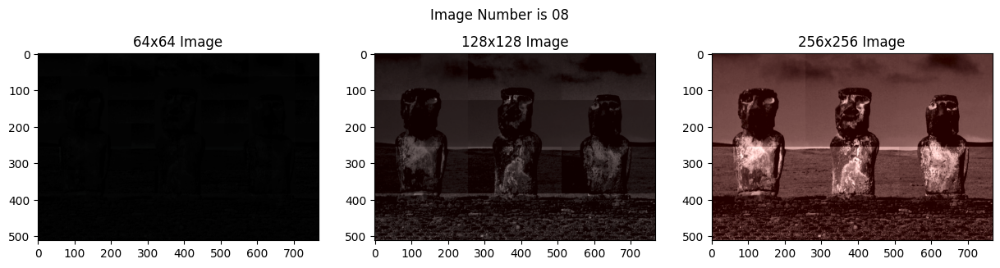

In [15]:
index_img = "08"
visualize_rect(index_img, 64,128, 256)

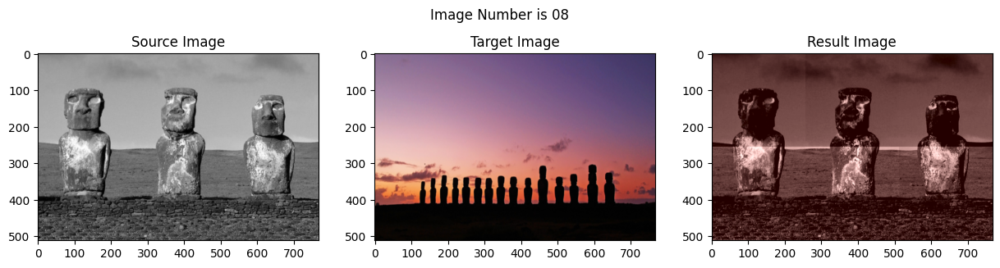

In [16]:
source_img, target_img, result_img = rect_process(index_img, 256)
visual_img(source_img, target_img, result_img,index_img )

## Image Num 09

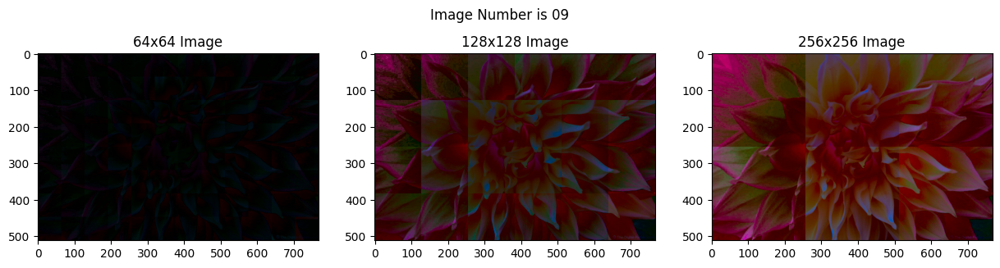

In [17]:
index_img = "09"
visualize_rect(index_img, 64,128, 256)

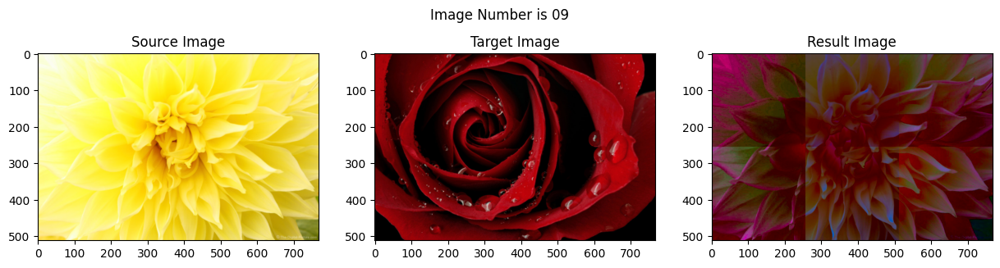

In [18]:
source_img, target_img, result_img = rect_process(index_img, 256)
visual_img(source_img, target_img, result_img,index_img )

## Image Num 11

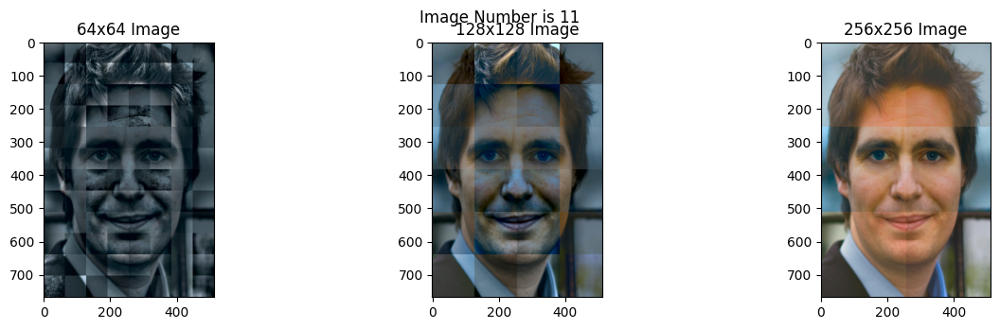

In [19]:
index_img = "11"
visualize_rect(index_img, 64,128, 256)

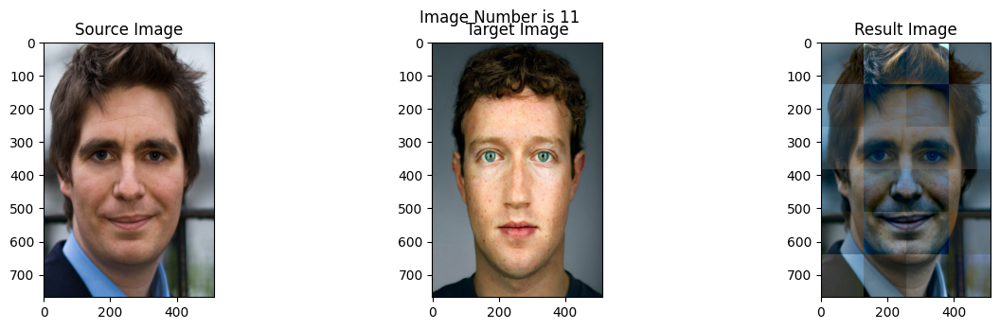

In [20]:
source_img, target_img, result_img = rect_process(index_img, 128)
visual_img(source_img, target_img, result_img,index_img )

## Image Num 15

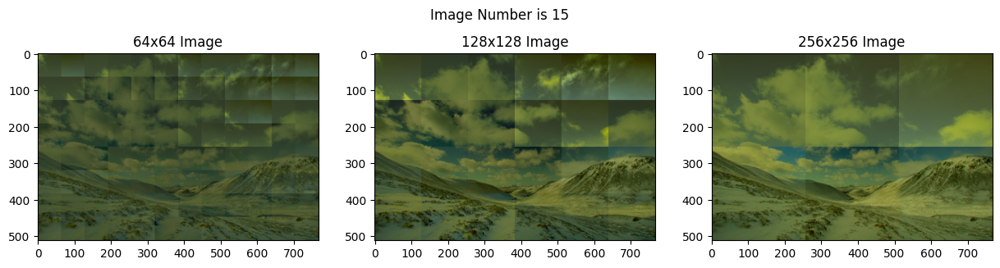

In [21]:
index_img = "15"
visualize_rect(index_img, 64,128, 256)

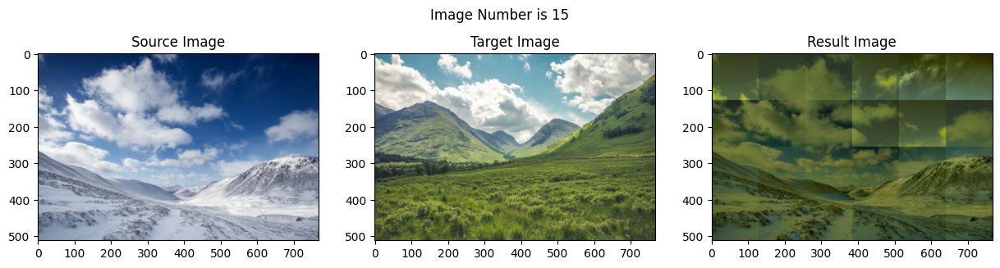

In [22]:
source_img, target_img, result_img = rect_process(index_img, 128)
visual_img(source_img, target_img, result_img,index_img )

## Image Num 20

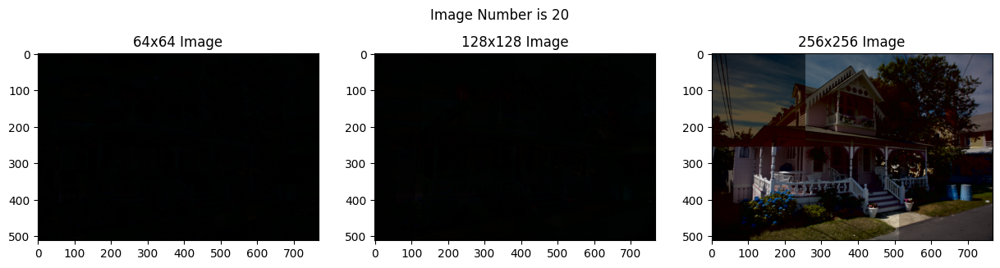

In [23]:
index_img = "20"
visualize_rect(index_img, 64,128, 256)

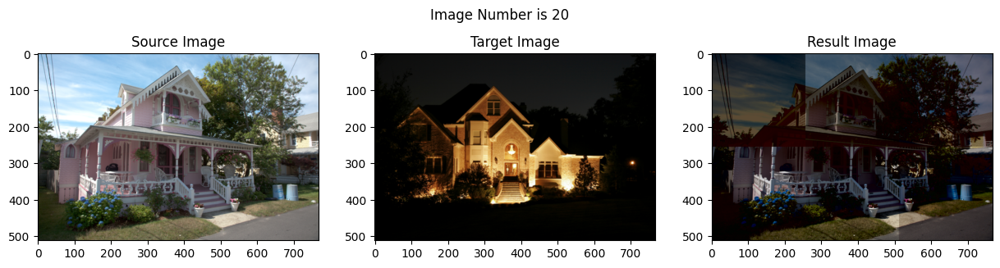

In [24]:
source_img, target_img, result_img = rect_process(index_img, 256)
visual_img(source_img, target_img, result_img,index_img )

## Image Num 24

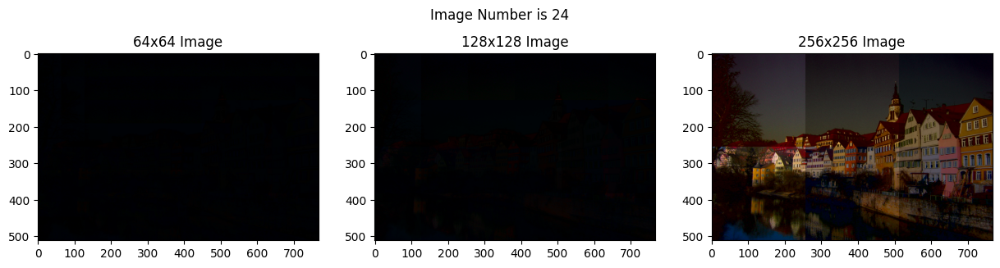

In [25]:
index_img = "24"
visualize_rect(index_img, 64,128, 256)

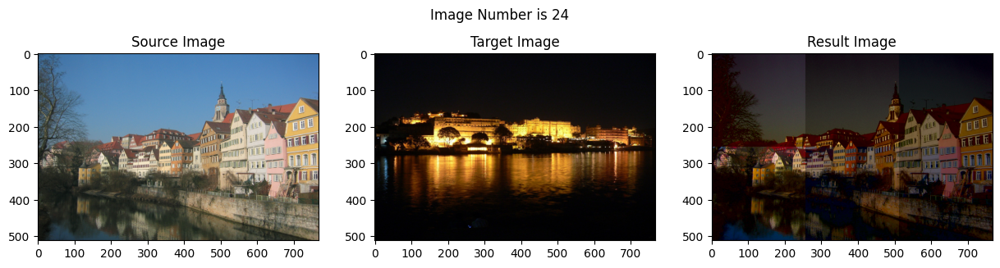

In [26]:
source_img, target_img, result_img = rect_process(index_img, 256)
visual_img(source_img, target_img, result_img,index_img )

## Image Num 29

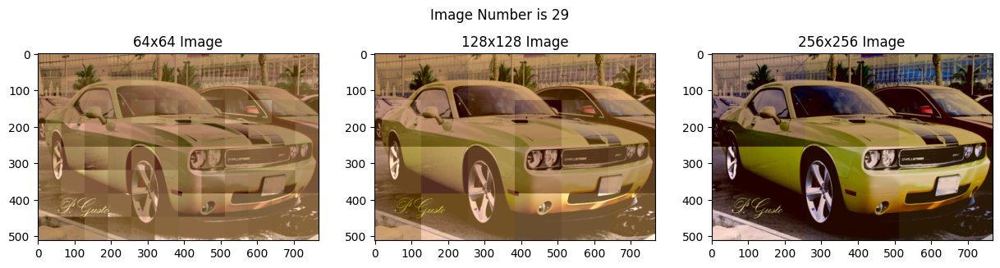

In [27]:
index_img = "29"
visualize_rect(index_img, 64,128, 256)

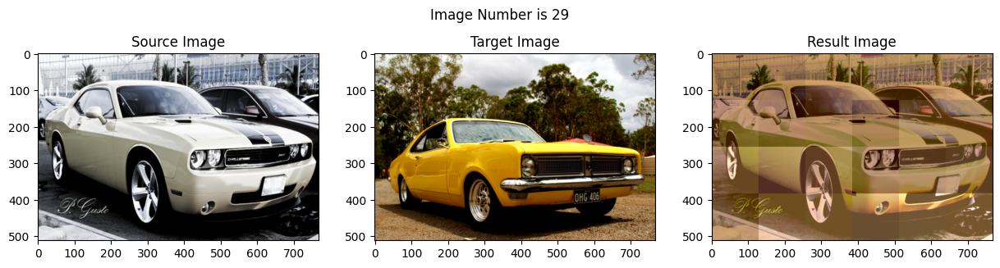

In [28]:
source_img, target_img, result_img = rect_process(index_img, 128)
visual_img(source_img, target_img, result_img,index_img )

## Image Num 50

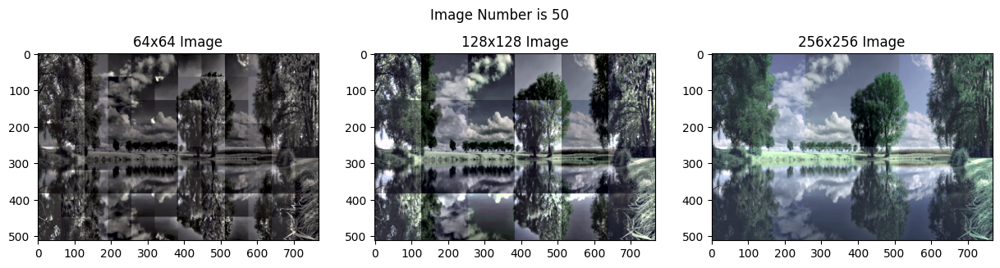

In [29]:
index_img = "50"
visualize_rect(index_img, 64,128, 256)

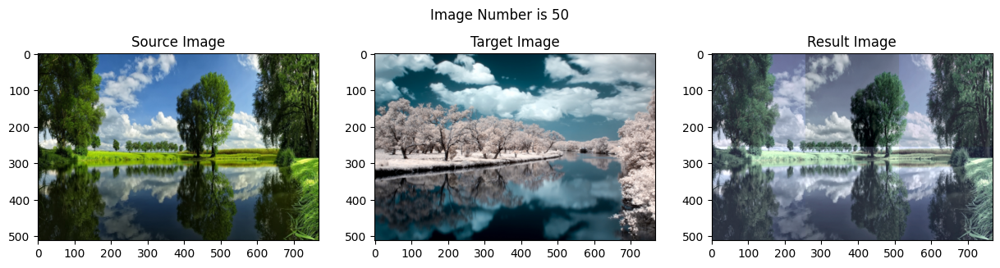

In [30]:
source_img, target_img, result_img = rect_process(index_img, 256)
visual_img(source_img, target_img, result_img,index_img )

## Image Num 51

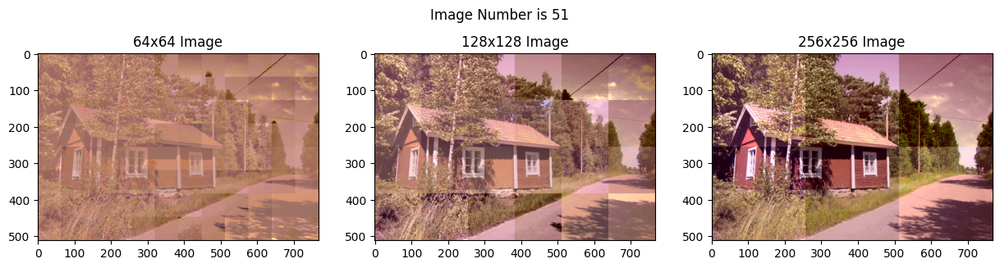

In [31]:
index_img = "51"
visualize_rect(index_img, 64,128, 256)

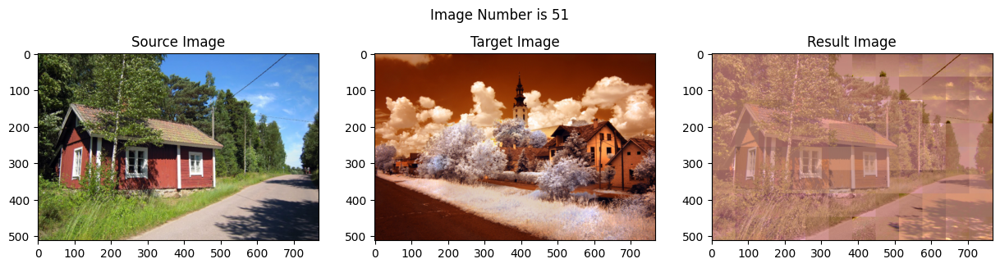

In [32]:
source_img, target_img, result_img = rect_process(index_img, 64)
visual_img(source_img, target_img, result_img,index_img )

## Image Num 56

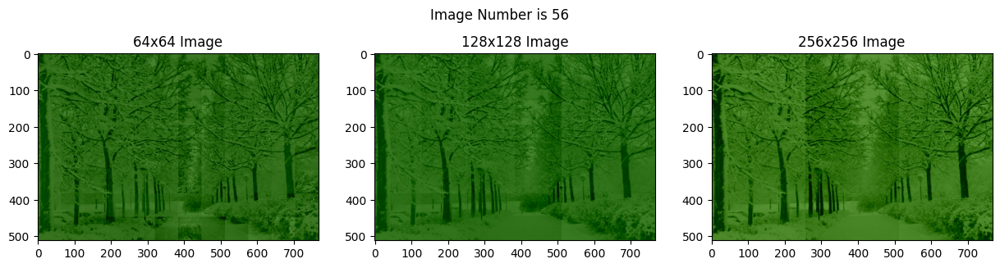

In [33]:
index_img = "56"
visualize_rect(index_img, 64,128, 256)

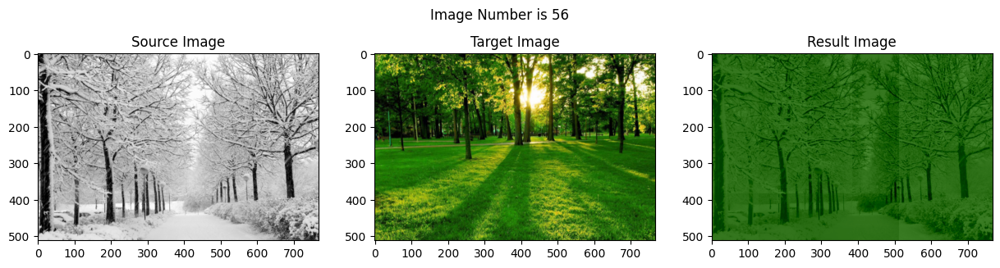

In [34]:
source_img, target_img, result_img = rect_process(index_img, 128)
visual_img(source_img, target_img, result_img,index_img )

# References

[1] D.L. Ruderman, T.W. Cronin, and C.C. Chiao, Statistics of Cone Responses to Natural Images: Implications for
Visual Coding, J. Optical Soc. of America, vol. 15, no. 8, 1998, pp. 2036-2045.

[2] Erik Reinhard, Michael Ashikhmin, Bruce Gooch and Peter Shirley, ’Color Transfer between Images’, IEEE
CG&A special issue on Applied Perception, Vol 21, No 5, pp 34-41, September - October 2001.

[3] Neural color transfer comparisons, https://mingminghe.com/neural_color_transfer/comparison.html